In [2]:
%load_ext autoreload
%autoreload 2
from pandas import DataFrame
%matplotlib inline
import vectorbtpro as vbt
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
from configs.config import Config
from vectorbtpro.data.custom import LocalDataT
from configs.comparisonConfig import ComparisonConfig
from configs.testDataConfig import TestDataConfig
import tensorflow as tf
from services.createPortfolioWrap import createPortfolioWrap
from services.createHistogramAndComparison import createHistogram
from services.createHistogramAndComparison import createComparison
gpu = len(tf.config.list_physical_devices('GPU'))>0
print("GPU is", "available" if gpu else "NOT AVAILABLE")

GPU is NOT AVAILABLE


In [6]:
barData: LocalDataT = vbt.HDFData.fetch(Config.relativeSymbolDownloadDataPath("C:CNYUSD"))
barData.data["C:CNYUSD"]

,Open,High,Low,Close,Volume,Trade count,VWAP
Open time,,,,,,,
2017-01-31 09:00:00+00:00,0.145260,0.145300,0.145260,0.145290,15.0,15,0.1453
2017-01-31 10:00:00+00:00,0.145300,0.145320,0.145250,0.145280,934.0,934,0.1453
2017-01-31 11:00:00+00:00,0.145270,0.145320,0.145240,0.145260,838.0,838,0.1453
2017-01-31 12:00:00+00:00,0.145270,0.145530,0.145180,0.145260,533.0,533,0.1453
2017-01-31 13:00:00+00:00,0.145290,0.145450,0.145240,0.145280,533.0,533,0.1453
...,...,...,...,...,...,...,...
2022-12-30 12:00:00+00:00,0.144921,0.144946,0.144645,0.144934,68.0,68,0.1449
2022-12-30 13:00:00+00:00,0.144743,0.144944,0.144739,0.144940,28.0,28,0.1449
2022-12-30 14:00:00+00:00,0.144753,0.145049,0.144753,0.145049,23.0,23,0.1450


In [4]:
comparisonCnyUsd50 = createComparison(TestDataConfig.symbolConfig("C:CNYUSD"),
                                      ComparisonConfig(Config.otherDir, "50", "C:CNYUSD"),
                                      "longEntry50", "shortEntry50")
createHistogram(comparisonCnyUsd50, Config.relativeSymbolDownloadDataPath("C:CNYUSD"),
                "C:CNYUSD", None)

 in fetchOrCreateSaveData
checkpoints/comparison/other/4_1_comparison_C:USDCNY_period_50_2017-2023.h5 file already exists


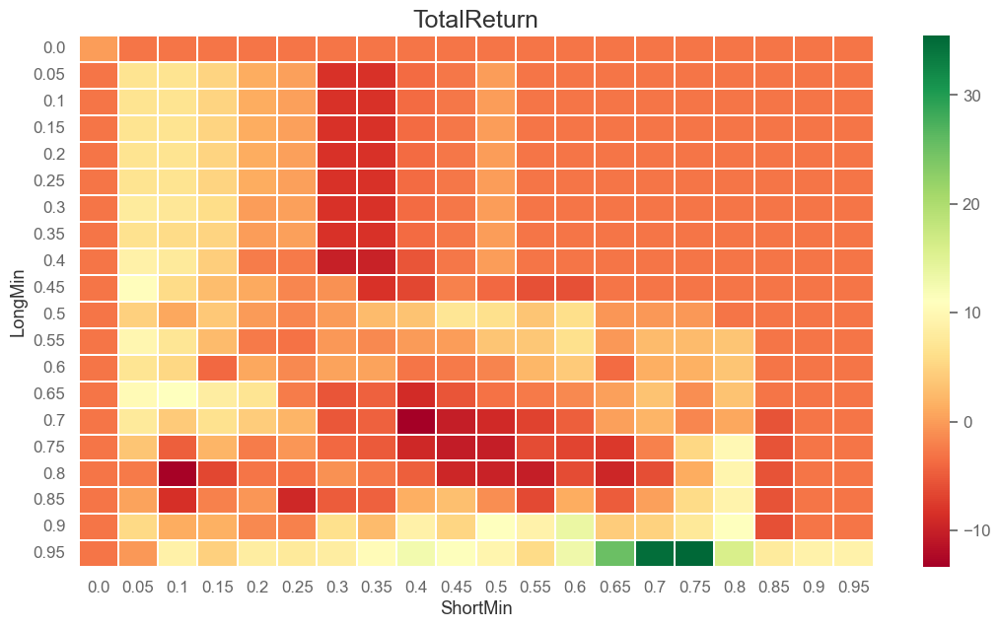

In [4]:
comparisonUsdCny50 = createComparison(TestDataConfig.symbolConfig("C:USDCNY"),
                                      ComparisonConfig(Config.otherDir, "50", "C:USDCNY"),
                                      "longEntry50", "shortEntry50")
createHistogram(comparisonUsdCny50, Config.relativeSymbolDownloadDataPath("C:USDCNY"),
                "C:USDCNY", None)

In [17]:
pf50UsdCnyWrap = createPortfolioWrap(Config.otherDir, Config.relativeSymbolDownloadDataPath('C:USDCNY'),
                                  'C:USDCNY', 50, .75, .6)
pf50UsdCny = pf50UsdCnyWrap.portfolio
pf50UsdCny.stats()

Start                         2017-01-11 01:00:00+00:00
End                           2022-12-31 00:00:00+00:00
Period                                            29652
Start Value                                11564.215605
Min Value                                   9998.912245
Max Value                                  11574.597155
End Value                                  10779.589099
Total Return [%]                              -6.784952
Benchmark Return [%]                           -0.38276
Total Time Exposure [%]                       99.983138
Max Gross Exposure [%]                            100.0
Max Drawdown [%]                              13.613302
Max Drawdown Duration                           17992.0
Total Orders                                        338
Total Fees Paid                                     0.0
Total Trades                                        338
Win Rate [%]                                  39.465875
Best Trade [%]                                 8

In [18]:
pf50UsdCny.get_orders()

In [19]:
pf50UsdCny.plot(settings=dict(bm_returns=True)).show()

In [20]:
barData: LocalDataT = vbt.HDFData.fetch(Config.relativeSymbolDownloadDataPath("C:USDCNY"))
barData.data["C:USDCNY"]

,Open,High,Low,Close,Volume,Trade count,VWAP
Open time,,,,,,,
2017-01-01 17:00:00+00:00,6.94370,6.94370,6.9437,6.9437,1.0,1,6.9437
2017-01-01 20:00:00+00:00,6.94375,6.94380,6.9437,6.9438,9.0,9,6.9438
2017-01-02 01:00:00+00:00,6.94370,6.94405,6.9437,6.9440,56.0,56,6.9439
2017-01-02 02:00:00+00:00,6.94390,6.94420,6.9438,6.9442,66.0,66,6.9440
2017-01-02 04:00:00+00:00,6.94425,6.94450,6.9438,6.9445,328.0,328,6.9443
...,...,...,...,...,...,...,...
2022-12-30 13:00:00+00:00,6.88880,6.89800,6.8883,6.8976,40.0,40,6.8970
2022-12-30 14:00:00+00:00,6.88830,6.89750,6.8832,6.8924,32.0,32,6.8935
2022-12-30 15:00:00+00:00,6.89360,6.89750,6.8871,6.8973,48.0,48,6.8954


In [21]:
barData: LocalDataT = vbt.HDFData.fetch(Config.relativeSymbolDownloadDataPath("X:DOGEUSD"))
barData.data["X:DOGEUSD"]

,Open,High,Low,Close,Volume,Trade count,VWAP
Open time,,,,,,,
2017-06-01 20:00:00+00:00,0.000100,0.000100,0.000100,0.000100,3.800000e+02,1,0.0001
2017-06-02 05:00:00+00:00,0.120999,0.120999,0.120999,0.120999,5.000000e+01,1,0.1210
2017-06-02 08:00:00+00:00,0.119997,0.200000,0.000124,0.009999,1.800000e+03,6,0.0035
2017-06-02 11:00:00+00:00,0.001402,0.001402,0.001402,0.001402,1.000000e+01,1,0.0014
2017-06-02 12:00:00+00:00,0.010000,0.010000,0.010000,0.010000,1.300000e+02,2,0.0100
...,...,...,...,...,...,...,...
2022-12-31 19:00:00+00:00,0.070140,0.070806,0.070031,0.070470,1.032389e+07,1579,0.0704
2022-12-31 20:00:00+00:00,0.070500,0.070847,0.070390,0.070540,5.886365e+06,1107,0.0705
2022-12-31 21:00:00+00:00,0.070550,0.070895,0.070330,0.070410,1.514273e+07,1690,0.0706


In [5]:
import numpy

dataConfig: tuple[numpy.ndarray, DataFrame, DataFrame] = TestDataConfig.symbolConfig("C:CNYUSD")
(testLaggedReturns, testFeatures2, testTargets)=dataConfig
testFeatures2

,CurrentOpen,Open,High,Low,Close,Volume,Trade count,VWAP,ad_real,add_real,...,trima_real,trix_real,tsf_real,typprice_real,ultosc_real,var_real,wclprice_real,willr_real,wma_real,outWQA1
Open time,,,,,,,,,,,,,,,,,,,,,
2017-02-07 11:00:00+00:00,0.145250,0.145250,0.145280,0.145240,0.145240,750.0,750.0,0.1453,-3312.706079,0.290520,...,0.145540,-0.000455,0.145160,0.145253,40.087409,1.040000e-10,0.145250,-93.877551,0.145418,0.5
2017-02-07 12:00:00+00:00,0.145270,0.145250,0.145290,0.145220,0.145260,795.0,795.0,0.1453,-3199.134650,0.290510,...,0.145519,-0.000880,0.145201,0.145257,43.083090,1.040000e-10,0.145257,-89.130435,0.145401,0.5
2017-02-07 13:00:00+00:00,0.145260,0.145270,0.145410,0.145150,0.145180,471.0,471.0,0.1453,-3561.442343,0.290560,...,0.145495,-0.001299,0.145176,0.145247,33.292845,1.056000e-09,0.145230,-91.666667,0.145381,0.5
2017-02-07 14:00:00+00:00,0.145290,0.145260,0.145350,0.145100,0.145280,487.0,487.0,0.1452,-3347.162343,0.290450,...,0.145471,-0.001689,0.145200,0.145243,40.850864,1.184000e-09,0.145253,-56.097561,0.145368,0.5
2017-02-07 15:00:00+00:00,0.145230,0.145290,0.145300,0.145180,0.145240,442.0,442.0,0.1453,-3347.162343,0.290480,...,0.145448,-0.002059,0.145211,0.145240,42.171929,1.120000e-09,0.145240,-65.853659,0.145353,0.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-30 12:00:00+00:00,0.144921,0.144645,0.144928,0.144624,0.144928,49.0,49.0,0.1448,985041.020408,0.289551,...,0.143628,0.003635,0.144408,0.144826,92.052515,1.484426e-07,0.144852,-0.000000,0.143819,0.5
2022-12-30 13:00:00+00:00,0.144743,0.144921,0.144946,0.144645,0.144934,68.0,68.0,0.1449,985103.344356,0.289591,...,0.143657,0.004316,0.144654,0.144842,92.237970,1.622687e-07,0.144865,-0.811547,0.143900,0.5
2022-12-30 14:00:00+00:00,0.144753,0.144743,0.144944,0.144739,0.144940,28.0,28.0,0.1449,985130.200332,0.289683,...,0.143691,0.005099,0.144857,0.144874,93.240773,1.311024e-07,0.144891,-0.405774,0.143978,0.5


In [6]:
dataConfig: tuple[numpy.ndarray, DataFrame, DataFrame] = TestDataConfig.symbolConfig("X:BTCUSD")
(testLaggedReturns, testFeatures2, testTargets)=dataConfig
testFeatures2

,CurrentOpen,Open,High,Low,Close,Volume,Trade count,VWAP,ad_real,add_real,...,trima_real,trix_real,tsf_real,typprice_real,ultosc_real,var_real,wclprice_real,willr_real,wma_real,outWQA1
Open time,,,,,,,,,,,,,,,,,,,,,
2017-01-06 02:00:00+00:00,1010.90,1024.25,1059.19599,1000.00,1021.00,3872.987036,3337.0,1021.1304,8.625030e+04,2059.19599,...,1057.208817,0.000976,1016.095418,1026.731997,57.651634,277.565944,1025.298998,-31.918723,1026.091211,0.5
2017-01-06 03:00:00+00:00,958.72,1010.90,1028.85999,940.00,945.95,4586.598048,4288.0,984.2671,8.227794e+04,1968.85999,...,1048.385725,-0.011813,1002.856593,971.603330,50.273393,743.282776,965.189998,-54.339124,1018.942974,0.5
2017-01-06 04:00:00+00:00,981.21,958.72,988.73900,945.00,985.28,3104.020964,2231.0,968.1012,8.489101e+04,1933.73900,...,1039.474512,-0.024037,998.188901,973.006333,51.966957,744.003864,976.074750,-53.102097,1014.577426,0.5
2017-01-06 05:00:00+00:00,975.98,981.21,989.46700,953.11,970.10,1531.461097,1616.0,975.9336,8.479088e+04,1942.57700,...,1031.151637,-0.036035,989.601978,970.892333,52.148470,782.517024,970.694250,-64.007584,1009.459275,0.5
2017-01-06 06:00:00+00:00,980.06,975.98,989.80900,969.00,980.59,1385.529025,1453.0,980.4855,8.494875e+04,1958.80900,...,1023.731179,-0.047434,990.062088,979.799667,48.442522,592.986744,979.997250,-56.471447,1005.394028,0.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00+00:00,16566.60,16573.80,16611.00000,16559.90,16567.48,938.190422,17882.0,16570.7030,-3.012695e+06,33170.90000,...,16558.688125,-0.006501,16593.512088,16579.460000,32.735186,84.470150,16576.465000,-65.659864,16565.971183,0.5
2022-12-31 20:00:00+00:00,16559.68,16566.60,16616.00000,16543.00,16559.76,1103.722971,19574.0,16564.1324,-3.013292e+06,33159.00000,...,16560.278458,-0.006036,16589.236154,16572.920000,29.172963,152.873966,16569.630000,-70.911565,16566.377936,0.5
2022-12-31 21:00:00+00:00,16555.80,16559.68,16602.00000,16550.41,16556.30,768.860591,15525.0,16558.0107,-3.013885e+06,33152.41000,...,16561.433000,-0.005616,16580.905714,16569.570000,22.831123,153.962926,16566.252500,-81.215595,16566.340710,0.5
